## PREDICCIÓN DE VENTAS DE NUEVOS LOCALES DE COMIDA RÁPIDA

## Presentación de la empresa

MTZ es una empresa Argentina de cómida rápida con más de 150 locales distribuidos por todo el país, dentro del sector compite con dos multinacionales como son BK y MCD, una de las mayores problemáticas al estar en un séctor tan competitivo es definir los mejores lugares para realizar una expansión eficiente y que cumpla con los objetivos de ventas fijados por eso una de las soluciones propuestas es realizar un modelo de ML el cual según los datos de los locales existentes se pueda analizar cuales funcionan mejor y realizar predicciones para futuras aperturas.

## Objetivos de la investigación

Dentro de los objetivos de la investigación está resolver las siguientes preguntas



*   ¿Qué tipo de formato tiene mayor facturación?
*   ¿Qué provincia es la que genera mayor facturación?
*   ¿En qué localidad?
*   ¿Cómo afecta la distribución de ventas según su proveniencia; Mostrador,Delivery y Auto?
*   ¿Qué meses son los que generan mayor venta?
*   ¿Funcionan mejor los locales propios o franquiciados?


En base a estas preguntas se podrá definir un modelo de predicción de ventas sobre nuevos aperturas en el que se defina donde es mejor realizar nuevas aperturas



## Equipo de trabajo

*Antonio Elvira García*

Tengo 35 años soy español y actualmente resido entre España y Argentina y me desempeño con gerente de expansión de la marca MTZ, teniendo la responsabilidad la apertura de nuevos locales de la marca en distintos paises.
Mi formación principal fue administración y operacional pero actualmente he incursionado en el mundo del análisis de datos lo que me lleva a cursar la carrera de Data Scientist en CoderHouse conocimientos que pretendo aplicar a mis responsabilidades actuales.

## Fuente del Dataset y criterios de selección

El dataset fue conformada con datos provenientes de distintas fuentes de información de la empresa como son el programa de facturación de ventas de los locales y la base de datos de los locales.

Se decidió tomar este Dataset porque contiene distinta información relevante de los locales actualmente abiertos por la marca para ser usada a la hora de definir el modelo que ayude a la expansión de la marca

## Explicación de los datos en el Dataset


1.   **Local**: Es el nombre interno de cada local
2.   **Tipologia**: Es el formato de cada local, existen varios tipos de locales:


*   **Auto**: Son locales en vía pública que tienen el sistema para poder pedir desde el auto.
*   **Vía Pública**: Son locales convencionales ubicados en la vía pública de las ciudades.
*   **Shopping**: Son locales ubicados dentro de Shoppings/Malls
*   **Aeropuerto**: Son los locales ubicados dentro de aeropuertos
*   **Parque temático**: Locales ubicados en parques de atracciones o de entretenemiento.
*   **Hotel**: Locales ubicados en complejos hoteleros.

3.  **Operador**: Se refiere a quién está cargo del local y sus operaciones puede ser de dos tipos;

*   **Propio**: Operados directamente por la marca.
*   **Franquicia**: La operación del local se realiza a través de un franquiciado.

4.  **Año_Apertura**: Año en el que se abrio el local
5.  **Mes_Apertura**: Número de mes en el que se abrió el local
6.  **Provincia**: Provincia de Argentina donde se encuentra ubicado el local.
7.  **Localidad**: Localidad de Argentina donde se encuentra ubicado el local.
8.  **Meses_Abierto_2019**: El número de meses de operación durante el 2019.
9.  **Meses_Abierto_2020**: El número de meses de operación durante el 2020.
10. **Meses_Abierto_2021**: El número de meses de operación durante el 2021.
11. **Meses_Abierto_2022**: El número de meses de operación durante el 2022.
12. **Total_Meses_Abierto**: Total de meses en los que ha estado abierto el local desde 2019 hasta el 2022.
13. **Ventas_2019**: Total de ventas año 2019.
14. **Ventas_2020**: Total de ventas año 2020.
15. **Ventas_2021**: Total de ventas año 2021.
16. **Ventas_2022**: Total de ventas año 2022.
17. **Total_Ventas**: Ventas totales desde el 2019 al 2022.
18.  **Ventas_Promedio_Mes**: Ventas promedio mensuales histórico.
19.  **Delivery_%**: % de las ventas del mes que son a través de la plataforma de delivery.
20.  **Auto_%**: % de las ventas del mes que son a través del sistema de Auto.
21.  **Mostrador_%**: % de las ventas que son generadas a través del mostrador.
12.  **Target**: El target es el grupo al que pertenecen los locales en función de sus niveles de ventas, existen cinco tipos de target:

*  **1**: Son los locales con ventas promedio mensuales entre 0 - 25 K USD
*  **2**: Son los locales con ventas promedio mensuales entre 25 - 50 K USD
*  **3**: Son los locales con ventas promedio mensuales entre 50 - 75 K USD
*  **4**: Son los locales con ventas promedio mensuales entre 75 - 100 K USD
*  **5**: Son los locales con ventas promedio mensuales mayores de 100 K USD






## Importamos las librerías

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('darkgrid')


## Cargamos el dataset y lo leemos

In [3]:
url='/content/drive/MyDrive/Data Scientist/MTZN.csv'
df = pd.read_csv(url, sep=';',encoding='latin-1')

## Visualizamos el dataset

In [4]:
df.head()

,Local,Tipologia,Operador,Año_Apertura,Mes_Apertura,Provincia,Localidad,Meses_Abierto_2019,Meses_Abierto_2020,Meses_Abierto_2021,...,Venta_2019,Venta_2020,Venta_2021,Venta_2022,Total_Ventas,Ventas_Promedio_Mes,Delivery_%,Auto_%,Mostrador_%,Target
0,F9DJ,Via Publica,Franquicia,2019,11,CABA,San Nicolas,2,8,12,...,46.14,247.10,346.70,70.29,710.23,29.59,0.24,0.0,0.76,2
1,FAMM,Shopping,Franquicia,2013,5,Mendoza,Maipu,12,8,12,...,410.62,272.58,426.31,108.38,1217.89,35.82,0.30,0.0,0.70,2
2,FAVE,Via Publica,Franquicia,2019,7,GBA Sur,Avellaneda,6,9,12,...,467.77,413.82,517.97,107.73,1507.29,51.97,0.39,0.0,0.61,3
3,FAVM,Via Publica,Franquicia,2017,1,CABA,San Nicolas,12,9,12,...,843.08,386.86,424.92,90.61,1745.47,49.87,0.32,0.0,0.68,2
4,FAVM2,Via Publica,Franquicia,2021,10,CABA,San Nicolas,0,0,3,...,0.00,0.00,78.20,78.66,156.86,31.37,0.00,0.0,1.00,2


## Size del dataset

In [5]:
df.shape

(149, 22)

## Tipos de datos

In [32]:
df.dtypes

Local                   object
Tipologia               object
Operador                object
Año_Apertura           float64
Mes_Apertura           float64
Provincia               object
Localidad               object
Meses_Abierto_2019     float64
Meses_Abierto_2020     float64
Meses_Abierto_2021     float64
Meses_Abierto_2022     float64
Total_Meses_Abierto    float64
Venta_2019             float64
Venta_2020             float64
Venta_2021             float64
Venta_2022             float64
Total_Ventas           float64
Ventas_Promedio_Mes    float64
Delivery_%             float64
Auto_%                 float64
Mostrador_%            float64
Target                  object
dtype: object

## Obtenemos el número total de registros por columnas

In [7]:
df.count()

Local                  149
Tipologia              149
Operador               149
Año_Apertura           149
Mes_Apertura           149
Provincia              149
Localidad              149
Meses_Abierto_2019     149
Meses_Abierto_2020     149
Meses_Abierto_2021     149
Meses_Abierto_2022     149
Total_Meses_Abierto    149
Venta_2019             149
Venta_2020             149
Venta_2021             149
Venta_2022             149
Total_Ventas           149
Ventas_Promedio_Mes    149
Delivery_%             149
Auto_%                 149
Mostrador_%            149
Target                 149
dtype: int64

## Más info acerca del dataframe

In [36]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 149 entries, 0 to 148
Data columns (total 22 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Local                149 non-null    object 
 1   Tipologia            149 non-null    object 
 2   Operador             149 non-null    object 
 3   Año_Apertura         149 non-null    int64  
 4   Mes_Apertura         149 non-null    int64  
 5   Provincia            149 non-null    object 
 6   Localidad            149 non-null    object 
 7   Meses_Abierto_2019   149 non-null    int64  
 8   Meses_Abierto_2020   149 non-null    int64  
 9   Meses_Abierto_2021   149 non-null    int64  
 10  Meses_Abierto_2022   149 non-null    int64  
 11  Total_Meses_Abierto  149 non-null    int64  
 12  Venta_2019           149 non-null    float64
 13  Venta_2020           149 non-null    float64
 14  Venta_2021           149 non-null    float64
 15  Venta_2022           149 non-null    flo

## Principales estadísticos

In [10]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Año_Apertura,149.0,2015.221477,5.066911,2002.00,2013.00,2017.00,2019.00,2021.00
Mes_Apertura,149.0,7.208054,3.669220,1.00,4.00,7.00,11.00,12.00
Meses_Abierto_2019,149.0,8.798658,4.860180,0.00,5.00,12.00,12.00,12.00
Meses_Abierto_2020,149.0,6.993289,3.429791,0.00,7.00,8.00,9.00,12.00
Meses_Abierto_2021,149.0,10.798658,2.970531,1.00,12.00,12.00,12.00,12.00
Meses_Abierto_2022,149.0,2.000000,0.000000,2.00,2.00,2.00,2.00,2.00
Total_Meses_Abierto,149.0,28.590604,9.884477,3.00,26.00,33.00,35.00,38.00
Venta_2019,149.0,617.703490,465.332622,0.00,226.75,622.67,902.55,2175.20
Venta_2020,149.0,343.295369,261.628170,0.00,171.22,308.90,463.12,1523.16
Venta_2021,149.0,508.702752,304.535454,1.77,270.94,492.39,672.55,1578.04


## EDA AÑO APERTURA

In [12]:
#Hacemos un conteo del año de apertura de los locales
df["Año_Apertura"].value_counts()

2019    26
2021    22
2017    14
2018    12
2016     9
2012     9
2015     9
2014     9
2013     8
2005     4
2004     4
2009     4
2008     3
2006     3
2020     3
2003     3
2010     2
2007     2
2011     2
2002     1
Name: Año_Apertura, dtype: int64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


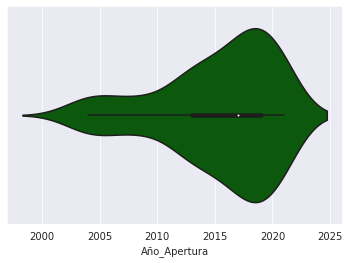

In [16]:
#Realizamos un gráfico de violín del año de apertura
from seaborn import violinplot
violinplot(df.Año_Apertura, data=df, color='Darkgreen')

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


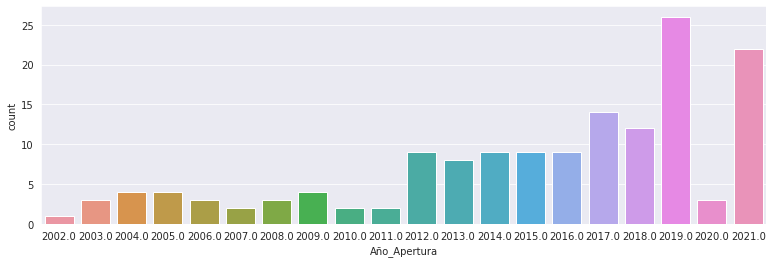

In [17]:
#Realizamos un gráfico de barras con los años de apertura
plt.figure(figsize=(13, 4))
sns.countplot(df['Año_Apertura'])

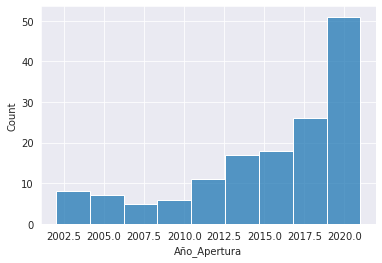

In [19]:
#Generamos un histograma
sns.histplot(df.Año_Apertura.dropna());

## EDA TIPOLOGÍA

In [20]:
#Hacemos un conteo de la tipologia de local
df["Tipologia"].value_counts()

Shopping           76
Via Publica        63
Auto                7
Parque Tematico     1
Aeropuerto          1
Hotel               1
Name: Tipologia, dtype: int64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


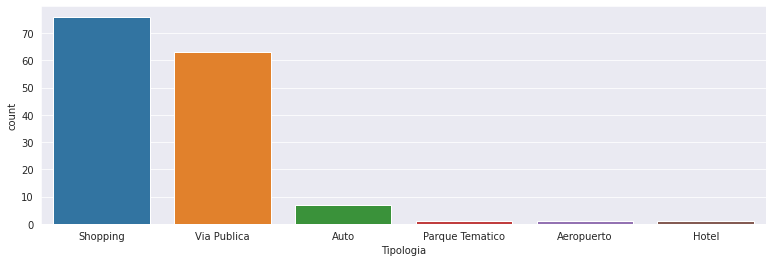

In [21]:
#Realizamos un gráfico de barras con los tipos de locales
plt.figure(figsize=(13, 4))
sns.countplot(df.Tipologia.dropna(), order = df.Tipologia.value_counts().index)

Distribucion de Frecuencias - Tipologia

In [6]:
#Contamos los valores de la columna Tipologia del df
frec = df["Tipologia"].value_counts()
frec

Shopping           76
Via Publica        63
Auto                7
Parque Tematico     1
Aeropuerto          1
Hotel               1
Name: Tipologia, dtype: int64

In [7]:
#Guardamos esta información en un dataframe
frec_df = pd.DataFrame(frec)
frec_df

,Tipologia
Shopping,76
Via Publica,63
Auto,7
Parque Tematico,1
Aeropuerto,1
Hotel,1


In [8]:
#Asignamos el nombre Frec_abs a la columna
frec_df.rename(columns={'Tipologia':'Frec_abs'},inplace=True)
frec_df

,Frec_abs
Shopping,76
Via Publica,63
Auto,7
Parque Tematico,1
Aeropuerto,1
Hotel,1


In [9]:
#Obtenemos los valores de las Frecuencias Absolutas
Frec_abs_val = frec_df["Frec_abs"].values

#Creamos una lista vacia en donde vamos a guardar las frecuencias absolutas acumuladas
acum = []

#Iniciamos una variable en la que guardaremos los valores anteriores
valor_acum = 0

#Recorremos la lista  de las frecuencias absolutas para irlas sumando
for i in Frec_abs_val:
    valor_acum = valor_acum + i
    acum.append(valor_acum)
    
frec_df["frec_abs_acum"] = acum
frec_df

,Frec_abs,frec_abs_acum
Shopping,76,76
Via Publica,63,139
Auto,7,146
Parque Tematico,1,147
Aeropuerto,1,148
Hotel,1,149


In [10]:
#Calculamos la Frecuencia Relativa en %
frec_df["frec_rel_%"] = 100 * frec_df["Frec_abs"]/len(df.Tipologia)
frec_df

,Frec_abs,frec_abs_acum,frec_rel_%
Shopping,76,76,51.006711
Via Publica,63,139,42.281879
Auto,7,146,4.697987
Parque Tematico,1,147,0.671141
Aeropuerto,1,148,0.671141
Hotel,1,149,0.671141


In [11]:
#Obtenemos los valores de las Frecuencias Relativas
Frec_rel_val = frec_df["frec_rel_%"].values

#Creamos una lista vacia en donde vamos a guardar las frecuencias relativas acumuladas
acum = []

#Iniciamos una variable  en la que guardaremos los valores anteriores
valor_acum = 0

#Recorremos la lista  de las frecuencias relativas para irlas sumando
for i in Frec_rel_val:
    valor_acum = valor_acum + i
    acum.append(valor_acum)
    
frec_df["frec_rel_%_acum"] = acum
frec_df

,Frec_abs,frec_abs_acum,frec_rel_%,frec_rel_%_acum
Shopping,76,76,51.006711,51.006711
Via Publica,63,139,42.281879,93.288591
Auto,7,146,4.697987,97.986577
Parque Tematico,1,147,0.671141,98.657718
Aeropuerto,1,148,0.671141,99.328859
Hotel,1,149,0.671141,100.000000


## EDA OPERADOR

In [22]:
#Contamos los valores de los operadores
df["Operador"].value_counts()

Franquicia    88
Propio        61
Name: Operador, dtype: int64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


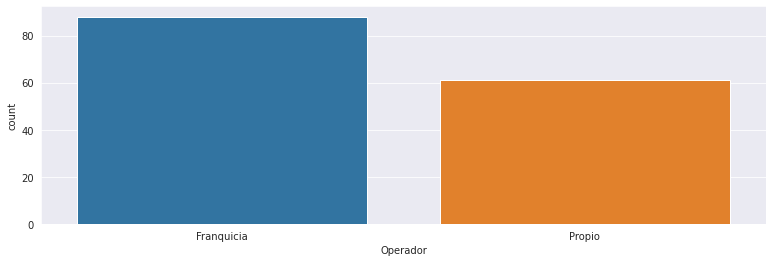

In [23]:
#Realizamos un gráfico de barras
plt.figure(figsize=(13, 4))
sns.countplot(df.Operador.dropna(), order = df.Operador.value_counts().index)

## EDA TARGET

In [37]:
#Hacemos un conteo
df["Target"].value_counts()

3    55
2    54
4    21
1    12
5     7
Name: Target, dtype: int64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_core.py:1326: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))


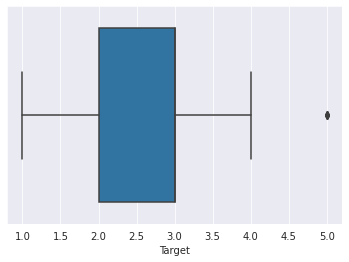

In [19]:
#Realizamos un boxplot para ver la distribución de los datos
from seaborn import boxplot
boxplot(df.Target, orient="v")

##EDA VENTAS

In [39]:
#Hacemos un describe de las ventas de 2019
df.Venta_2019.describe()

count     149.000000
mean      617.703490
std       465.332622
min         0.000000
25%       226.750000
50%       622.670000
75%       902.550000
max      2175.200000
Name: Venta_2019, dtype: float64

In [13]:
#Hacemos un describe de las ventas de 2020
df.Venta_2020.describe()

count     149.000000
mean      343.295369
std       261.628170
min         0.000000
25%       171.220000
50%       308.900000
75%       463.120000
max      1523.160000
Name: Venta_2020, dtype: float64

In [14]:
#Hacemos un describe de las ventas de 2021
df.Venta_2021.describe()

count     149.000000
mean      508.702752
std       304.535454
min         1.770000
25%       270.940000
50%       492.390000
75%       672.550000
max      1578.040000
Name: Venta_2021, dtype: float64

In [15]:
#Hacemos un describe de las ventas de 2022
df.Venta_2022.describe()

count    149.000000
mean     136.426376
std       69.732622
min        0.000000
25%       85.960000
50%      131.200000
75%      176.900000
max      371.380000
Name: Venta_2022, dtype: float64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


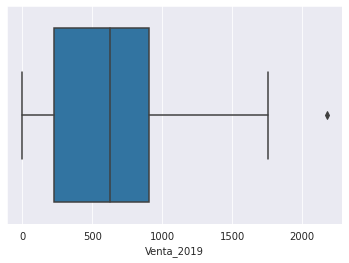

In [20]:
#Realizamos un boxplot de las ventas de 2019 para ver la distribución
boxplot(df.Venta_2019)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


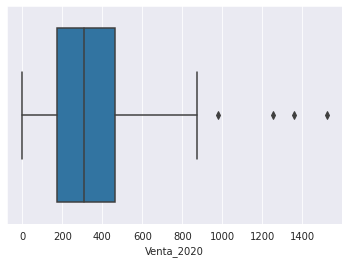

In [21]:
#Realizamos un boxplot de las ventas de 2020 para ver la distribución
boxplot(df.Venta_2020)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


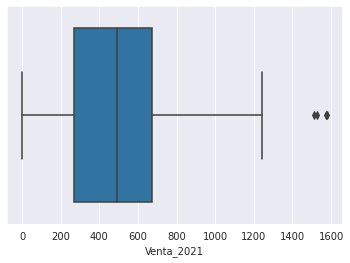

In [22]:
#Realizamos un boxplot de las ventas de 2021 para ver la distribución
boxplot(df.Venta_2021)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


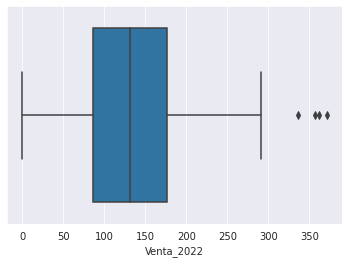

In [23]:
#Realizamos un boxplot de las ventas de 2022 para ver la distribución
boxplot(df.Venta_2022)

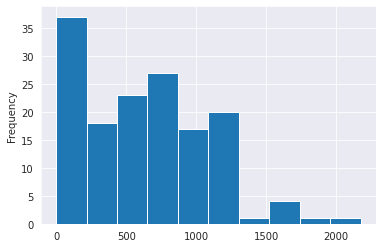

In [43]:
#Realizamos un histograma de las ventas de 2019
df['Venta_2019'].plot.hist()

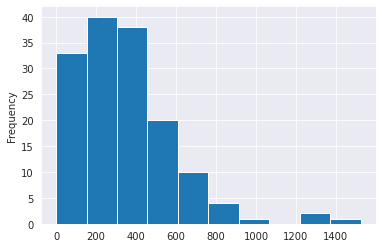

In [24]:
#Realizamos un histograma de las ventas de 2020
df['Venta_2020'].plot.hist()

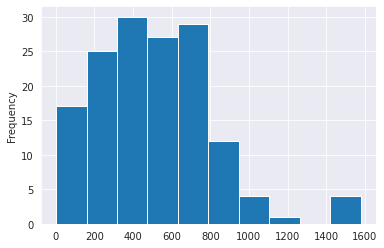

In [25]:
#Realizamos un histograma de las ventas de 2021
df['Venta_2021'].plot.hist()

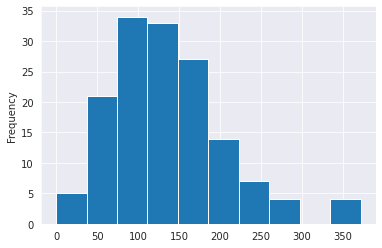

In [26]:
#Realizamos un histograma de las ventas de 2022
df['Venta_2022'].plot.hist()

##EDA PROVINCIA/LOCALIDAD

In [44]:
#Hacemos un conteo de los locales por provincia
df["Provincia"].value_counts()

CABA                     33
GBA Sur                  27
GBA Norte                19
GBA Oeste                17
Buenos Aires Interior     7
Santa Fe                  7
Cordoba                   6
Mendoza                   4
Tucuman                   4
Salta                     4
Neuquen                   4
Chubut                    3
Tierra del Fuego          2
San Juan                  2
Rio Negro                 2
Jujuy                     1
Entre Rios                1
Corrientes                1
Catamarca                 1
Santa Cruz                1
Santiago del estero       1
San Luis                  1
La Pampa                  1
Name: Provincia, dtype: int64

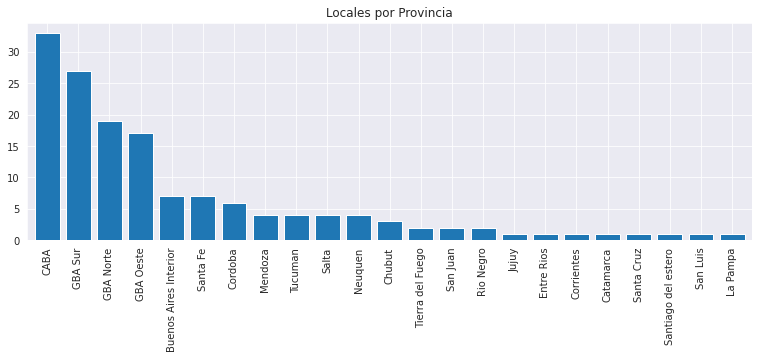

In [45]:
#Realizamos un gráfico de barras para ver el número de locales por provincia
plt.figure(figsize=(13, 4))
df['Provincia'].value_counts().plot.bar(width = 0.8, title = 'Locales por Provincia')

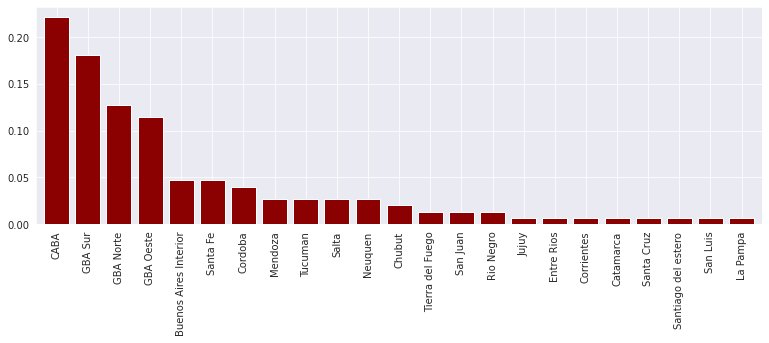

In [46]:
#Para visualizar mejor hacemos un gráfico representando el % de locales por provincia
plt.figure(figsize=(13, 4))
(df['Provincia'].value_counts() / len(df)).plot.bar(color = 'Darkred', width = 0.8)

In [47]:
#Hacemos un conteo de los locales por localidad
df["Localidad"].value_counts()

San Nicolas            9
La Plata               6
Salta                  4
Neuquen                4
Rosario                4
                      ..
Parana                 1
Pacheco                1
Mataderos              1
Moron                  1
Comodoro Rivadavia     1
Name: Localidad, Length: 96, dtype: int64

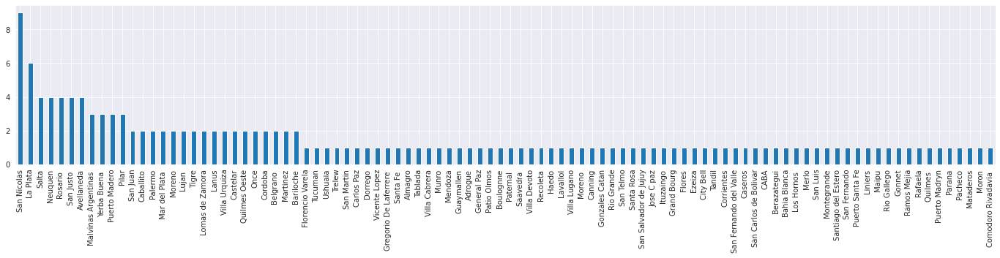

In [48]:
#Realizamos un gráfico de barras para ver el número de locales por localidad
plt.figure(figsize=(24, 4))
df['Localidad'].value_counts().plot.bar()

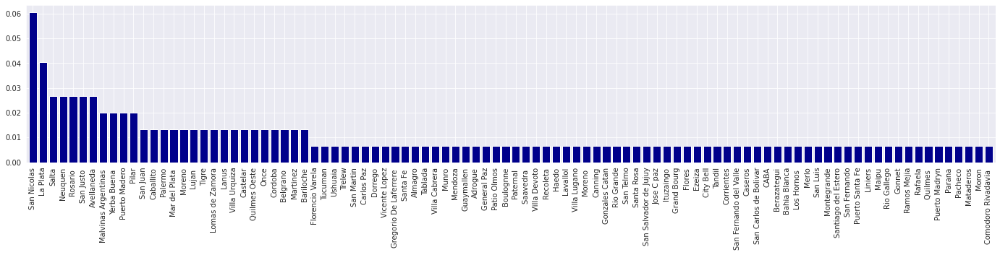

In [49]:
#Para visualizar mejor hacemos un gráfico representando el % de locales por localidad
plt.figure(figsize=(24, 4))
(df['Localidad'].value_counts() / len(df)).plot.bar(color = 'darkblue', width=0.8)

##EDA POR CANAL DE VENTAS

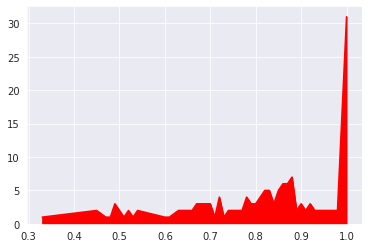

In [51]:
#Creamos un gráfico de área de la variable venta mostrador
df['Mostrador_%'].value_counts().sort_index().plot.area(color = 'red')

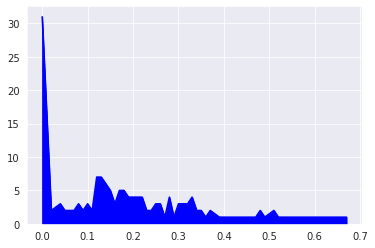

In [52]:
#Creamos un gráfico de área de la variable venta delivery
df['Delivery_%'].value_counts().sort_index().plot.area(color = 'blue')

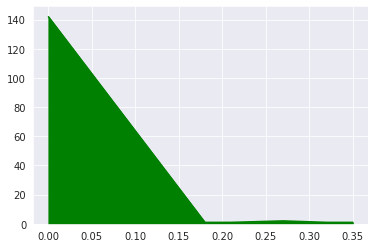

In [53]:
#Creamos un gráfico de área de la variable venta auto
df['Auto_%'].value_counts().sort_index().plot.area(color = 'green')

## ANÁLISIS BIVARIADO

In [5]:
#Sacamos el reporte de pandas profile
import pandas_profiling
profile = pandas_profiling.ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

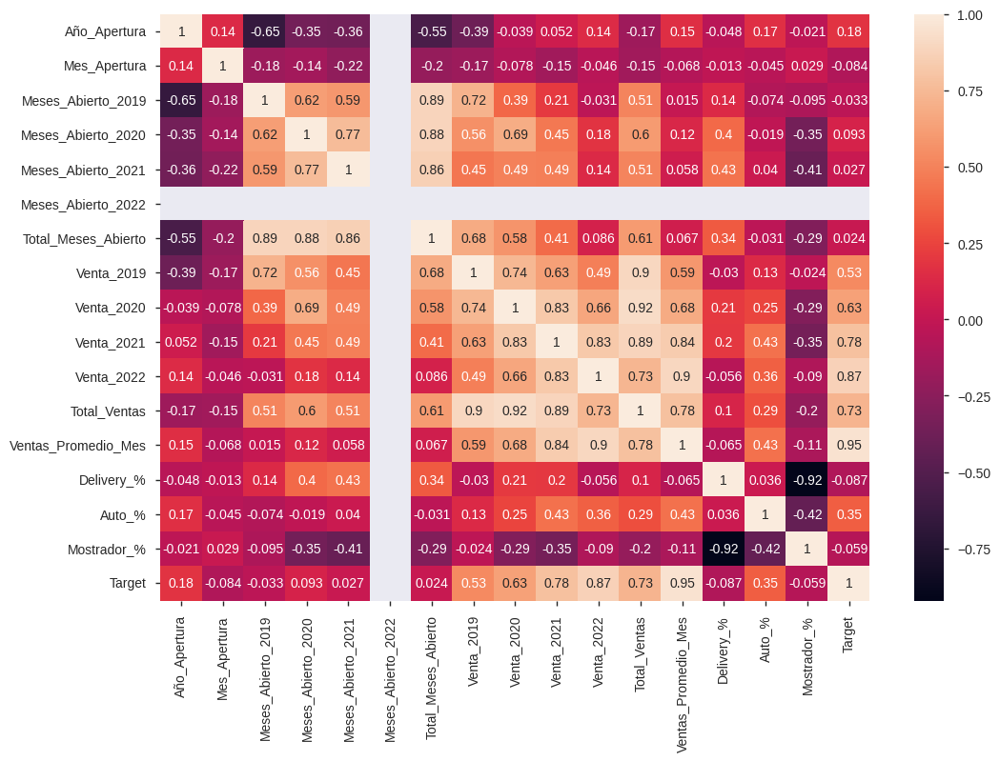

In [31]:
# Hacemos un gráfico con las correlaciones
plt.figure(figsize=(12, 8))
df_corr = df.corr()
sns.heatmap(df_corr, 
            xticklabels = df_corr.columns.values,
            yticklabels = df_corr.columns.values,
            annot = True);

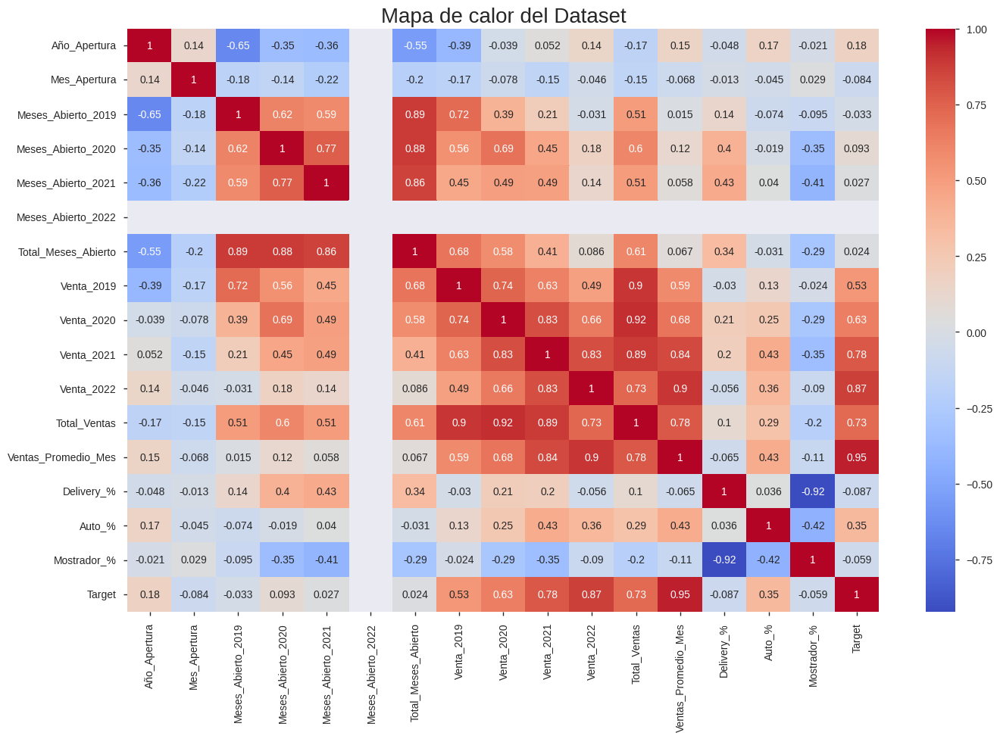

In [39]:
#Hacemos un HeatMap del df
plt.rcParams['figure.figsize'] = (16, 10)
sns.heatmap(df.corr(), annot = True, cmap = 'coolwarm')
plt.title('Mapa de calor del Dataset', fontsize = 20)
plt.show()

([<matplotlib.axis.XTick at 0x7fd32dcddcd0>,
 <a list of 10 Text major ticklabel objects>)

<Figure size 10000x5000 with 0 Axes>

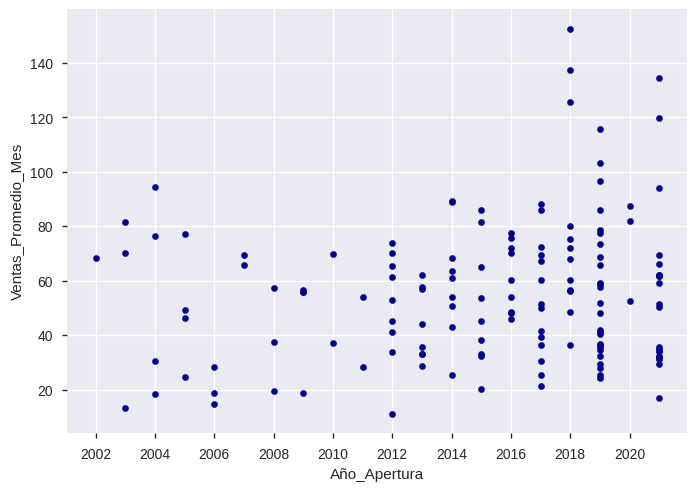

In [36]:
# Hacemos un Scatterplot con el año de apertura y las ventas promedio mes
plt.figure(figsize=(100, 50))
df.plot.scatter(x='Año_Apertura', y='Ventas_Promedio_Mes', color='darkblue')
plt.xticks(range(2002, 2021, 2))

Text(0.5, 1.0, 'Relación entre año apertura y ventas anuales')

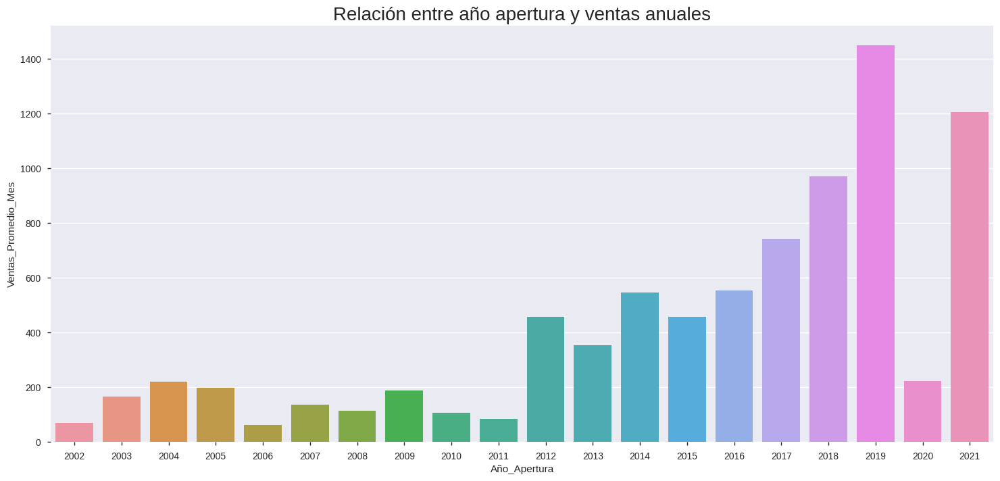

In [38]:
#Hacemos un gráfico de barras agrupando por año de apertura y ventas anuales
Vts_Apertura = df[["Año_Apertura", "Ventas_Promedio_Mes"]].groupby(['Año_Apertura'], as_index=False).sum().sort_values(by='Ventas_Promedio_Mes', ascending=False)
plt.figure(figsize=(18,8))
sns.barplot(x='Año_Apertura', y='Ventas_Promedio_Mes', data=Vts_Apertura)
plt.title('Relación entre año apertura y ventas anuales', fontsize = 20)

Text(0.5, 1.0, 'Ventas Promedio Mes y Tipologia')

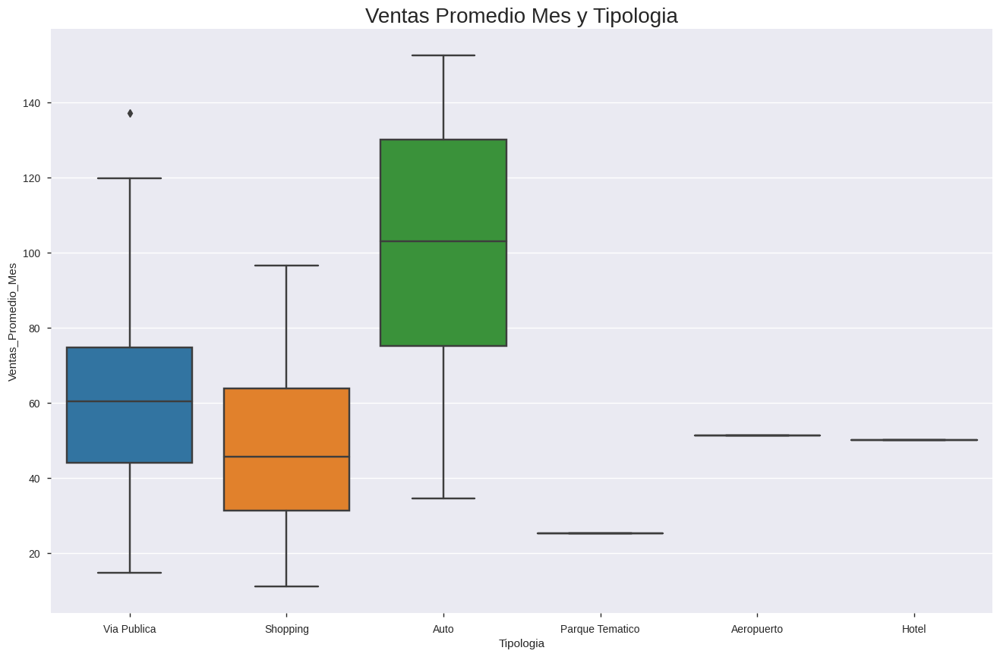

In [40]:
#Hacemos un gráfico de caja con la relación entre la tipologia y las ventas promedio
sns.boxplot(x=df['Tipologia'], y=df['Ventas_Promedio_Mes'])
plt.title('Ventas Promedio Mes y Tipologia', fontsize = 20)

In [41]:
#Generamos una crosstab viendo la cantidad de locales por provincia y tipo de operador
pd.crosstab(df.Provincia, df.Operador)

Operador,Franquicia,Propio
Provincia,,
Buenos Aires Interior,6,1
CABA,14,19
Catamarca,1,0
Chubut,1,2
Cordoba,3,3
Corrientes,1,0
Entre Rios,1,0
GBA Norte,11,8
GBA Oeste,8,9


In [42]:
 #Agregamos los valores en relativo
round((pd.crosstab(df.Provincia, df.Operador, normalize=True)*100), 2)

Operador,Franquicia,Propio
Provincia,,
Buenos Aires Interior,4.03,0.67
CABA,9.40,12.75
Catamarca,0.67,0.00
Chubut,0.67,1.34
Cordoba,2.01,2.01
Corrientes,0.67,0.00
Entre Rios,0.67,0.00
GBA Norte,7.38,5.37
GBA Oeste,5.37,6.04


In [43]:
#Análisis de las ventas promedio por tipo de operador
df.groupby('Operador')['Ventas_Promedio_Mes'].mean()

Operador
Franquicia    58.305682
Propio        51.666721
Name: Ventas_Promedio_Mes, dtype: float64

In [44]:
#Análisis de ventas promedio por Provincia
df.groupby('Provincia')['Ventas_Promedio_Mes'].mean().sort_values(ascending=False)

Provincia
Catamarca                119.940000
Entre Rios                78.740000
Tucuman                   66.587500
Santa Fe                  64.022857
Santa Cruz                61.000000
Buenos Aires Interior     59.200000
GBA Norte                 59.199474
San Luis                  58.770000
Cordoba                   58.735000
GBA Sur                   57.447407
Jujuy                     56.430000
Salta                     55.015000
La Pampa                  53.860000
CABA                      52.502727
GBA Oeste                 52.500000
San Juan                  51.085000
Rio Negro                 48.065000
Tierra del Fuego          46.845000
Chubut                    46.590000
Neuquen                   46.240000
Mendoza                   40.260000
Santiago del estero       38.100000
Corrientes                35.630000
Name: Ventas_Promedio_Mes, dtype: float64

In [45]:
#Análisis de ventas por canal en función de su tipología
Canal_venta_tipologia = round((df.groupby(['Tipologia']).mean()[['Mostrador_%', 'Auto_%', 'Delivery_%']]*100),2)
Canal_venta_tipologia

,Mostrador_%,Auto_%,Delivery_%
Tipologia,,,
Aeropuerto,100.00,0.00,0.00
Auto,52.00,27.71,20.29
Hotel,100.00,0.00,0.00
Parque Tematico,98.00,0.00,2.00
Shopping,84.78,0.00,15.22
Via Publica,80.81,0.00,19.19


Text(0.5, 1.0, 'Canal de venta por Tipologia')

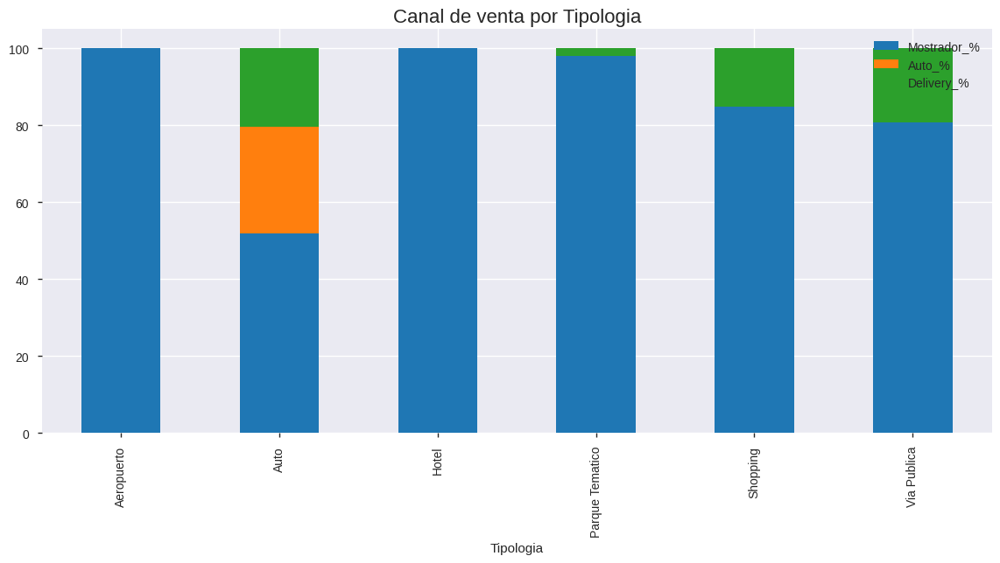

In [46]:
#Generamos un gráfico de barras con la agrupación anterior
plt.rcParams['figure.figsize'] = (14, 6)
Canal_venta_tipologia.plot.bar(stacked=True)
plt.title('Canal de venta por Tipologia', fontsize = 16)

##ANÁLISIS MULTIVARIADO DE LOS DATOS

<Figure size 1680x720 with 0 Axes>

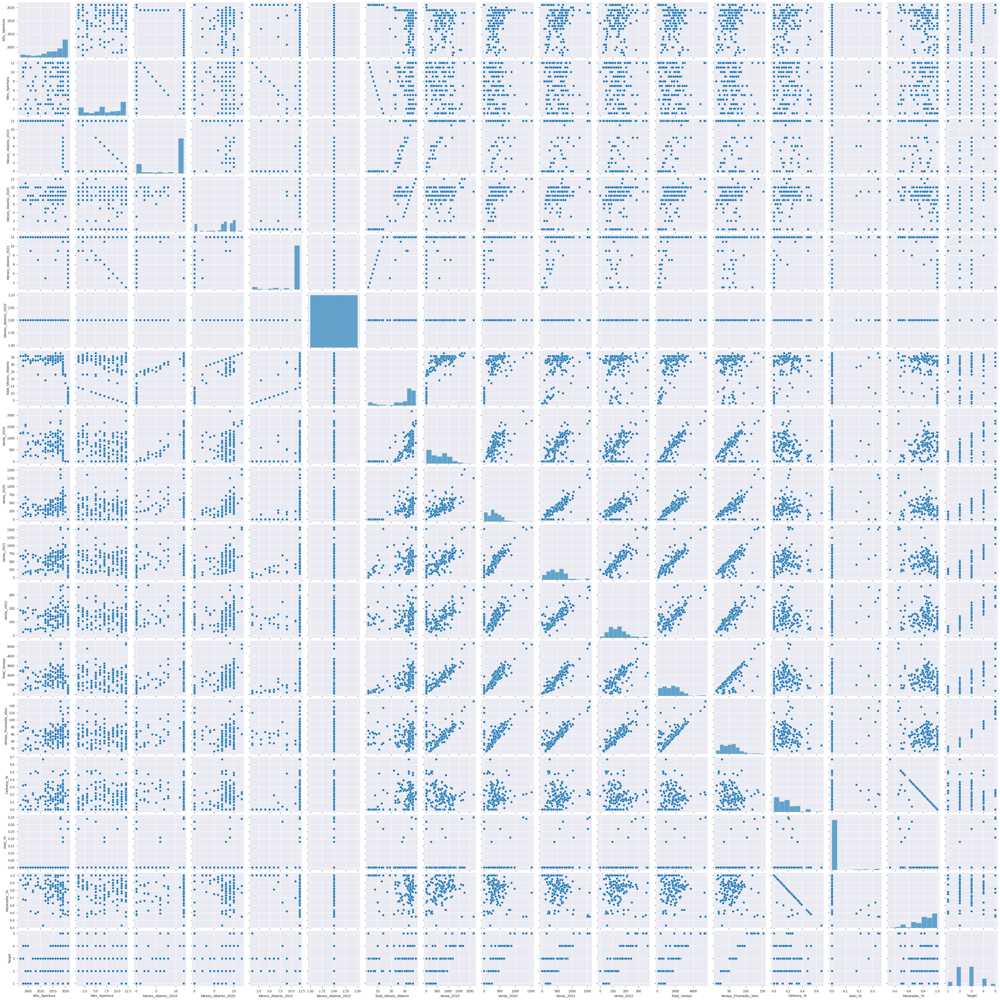

In [47]:
#Creamos un Pairplot del dataset
plt.figure(dpi=120)
sns.pairplot(df)
plt.show()

<Figure size 1680x720 with 0 Axes>

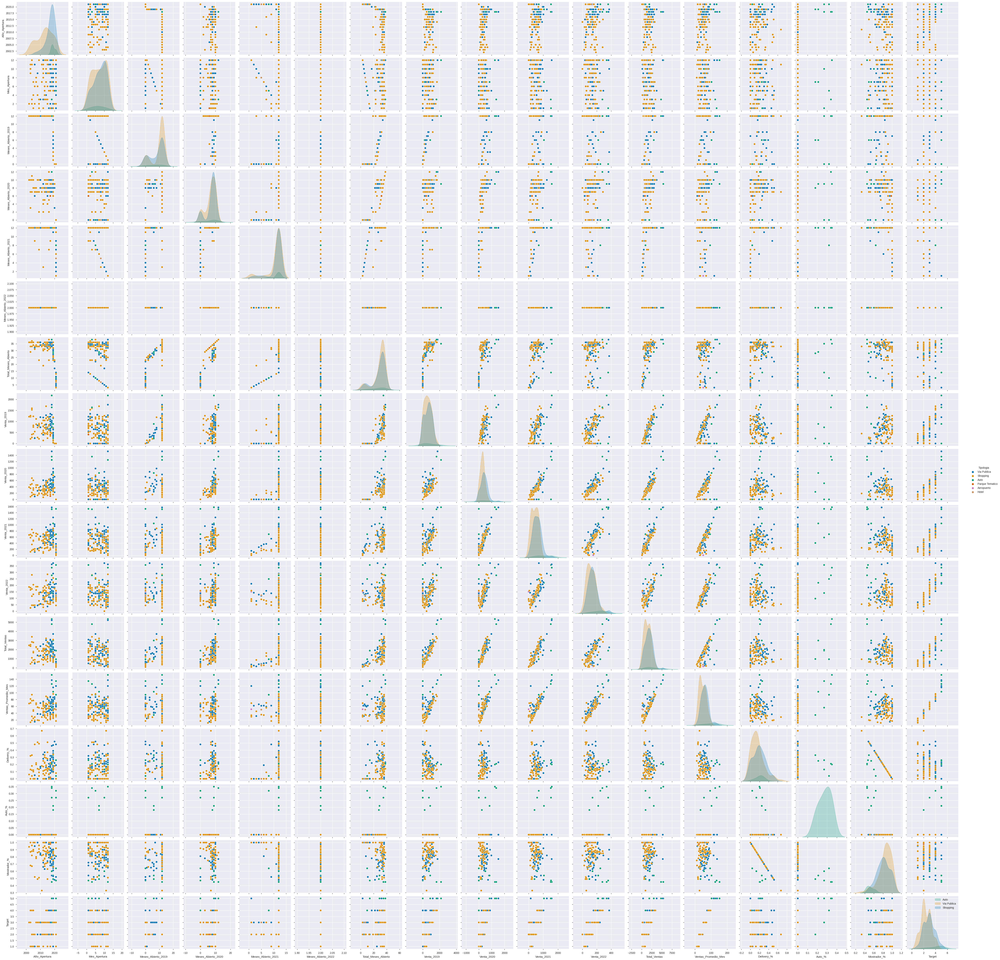

In [48]:
#Creamos un Pairplot del dataset pero ahora con el atributo hue = 'Tipologia' 
plt.figure(dpi = 120)
sns.pairplot(df,hue = 'Tipologia',palette = 'colorblind', height=3)
plt.legend(['Auto','Via Publica','Shopping','Aeropuerto'])
plt.show()

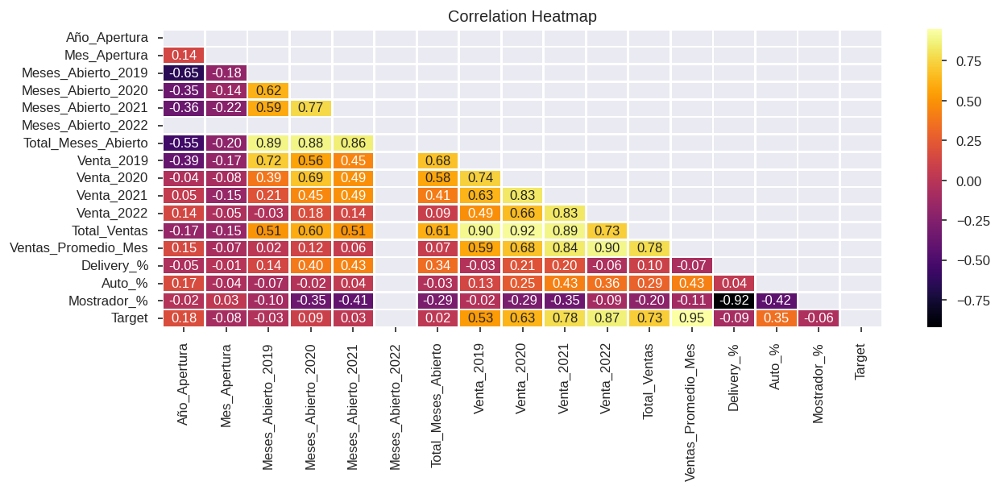

In [51]:
#Correlaciones
plt.figure(dpi = 120,figsize= (12,4))
mask = np.triu(np.ones_like(df.corr(),dtype = bool))
sns.heatmap(df.corr(),mask = mask, fmt = ".2f",annot=True,lw=1,cmap = 'inferno')
plt.yticks(rotation = 0)
plt.xticks(rotation = 90)
plt.title('Correlation Heatmap')
plt.show()

Joint plot de Target con otras variables ==> 

Correlacion entre Total Ventas y Ventas_Promedio_Mes ==>  0.7837321407816692
Correlacion entre Total Ventas y Delivery_% ==>  0.10010843580238622
Correlacion entre Total Ventas y Auto_% ==>  0.2880883466007988
Correlacion entre Total Ventas y Mostrador_% ==>  -0.2033148294273403


<Figure size 500x400 with 0 Axes>

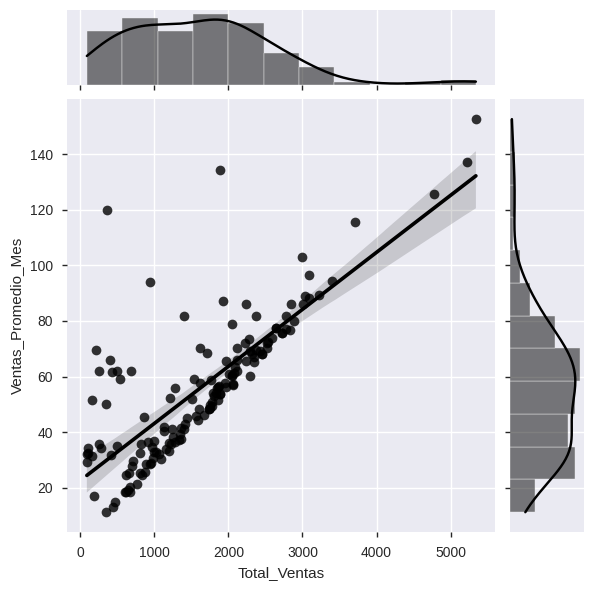

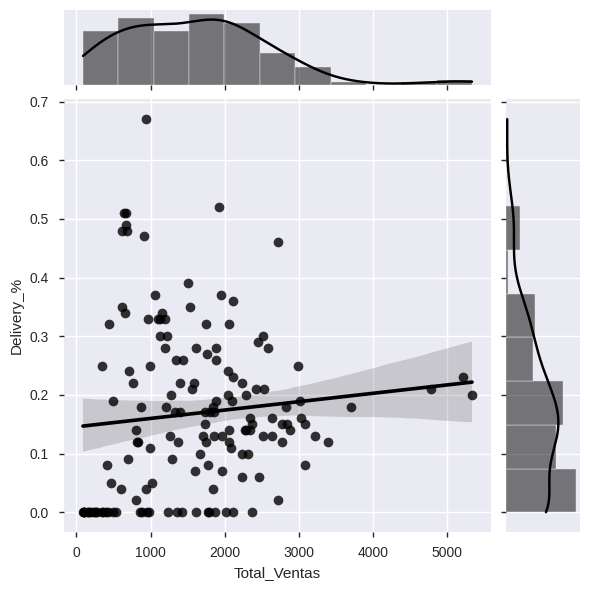

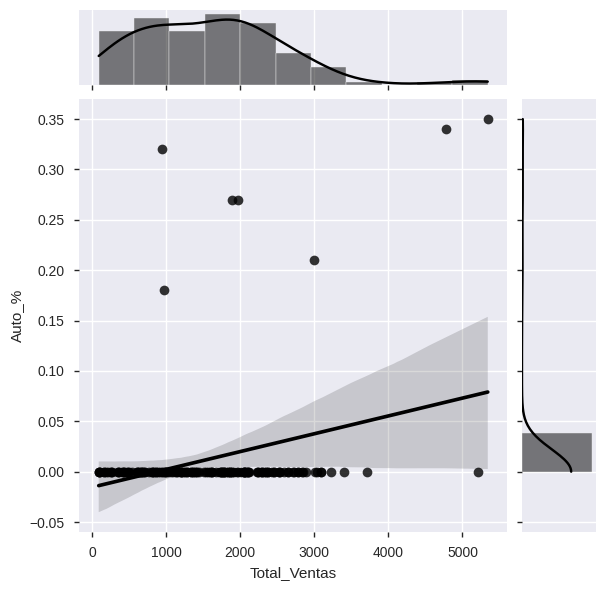

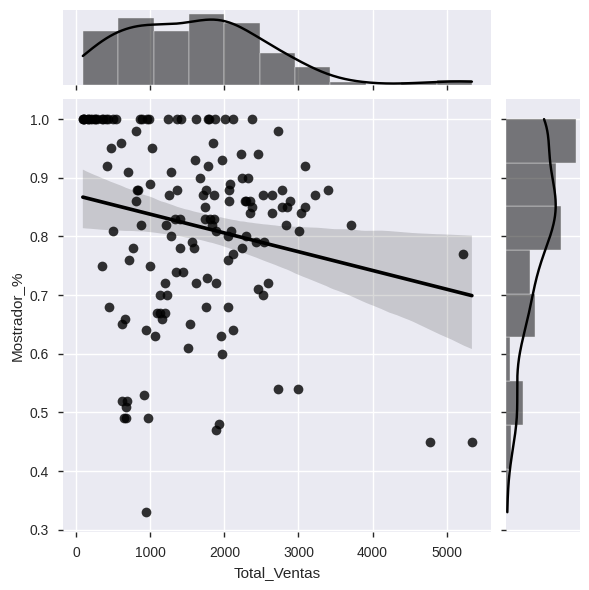

In [64]:
#Crear el join plot entre Total_Ventas y el resto de las variables con su correspondiente interpretación.

col = list(df.columns)
idx = col.index('Total_Ventas')

plt.figure(dpi = 100, figsize = (5,4))
print("Joint plot de Target con otras variables ==> \n")
for i in  range(idx+1,len(col)-1):
    print(f"Correlacion entre Total Ventas y {col[i]} ==> ",df.corr().loc['Total_Ventas'][col[i]])
    sns.jointplot(x='Total_Ventas',y=col[i],data=df,kind = 'reg',color = 'black')
    plt.show()

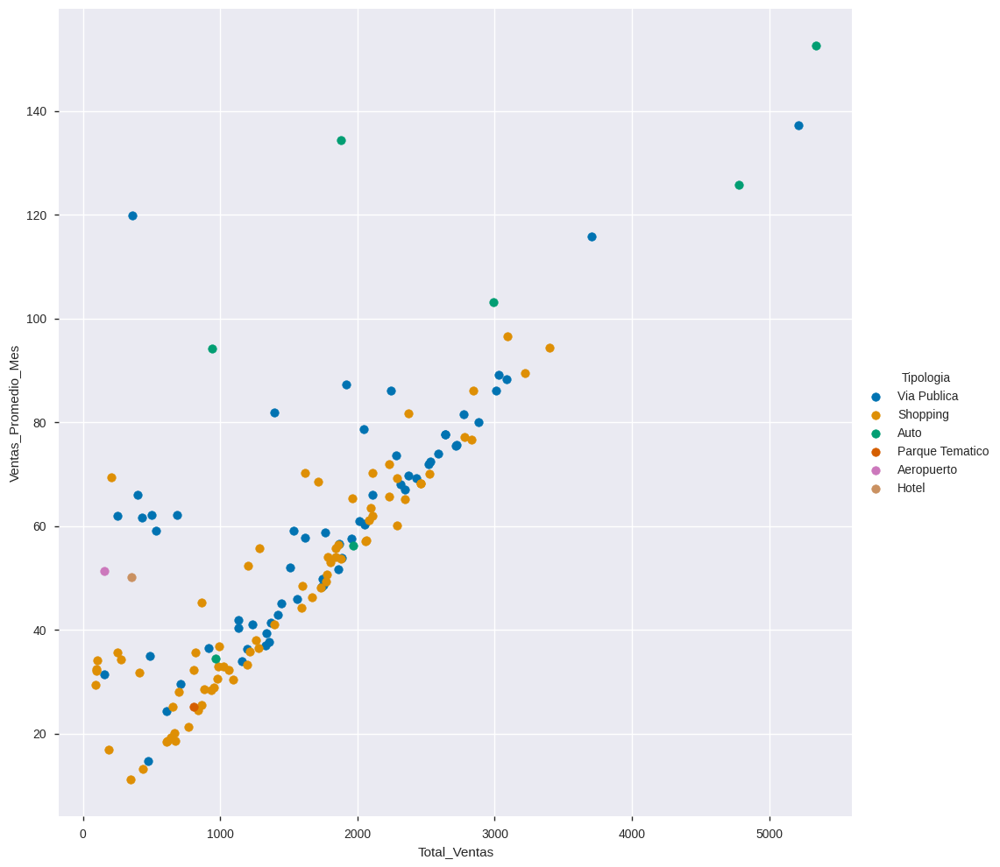

In [53]:
# Hacemos un FacetGrid de Tipologia 'Total_Ventas' vs 'Ventas_Promedio_Mes'
sns.FacetGrid(df,hue = 'Tipologia' , palette = 'colorblind', height = 10).map(plt.scatter,'Total_Ventas','Ventas_Promedio_Mes').add_legend();
plt.show()

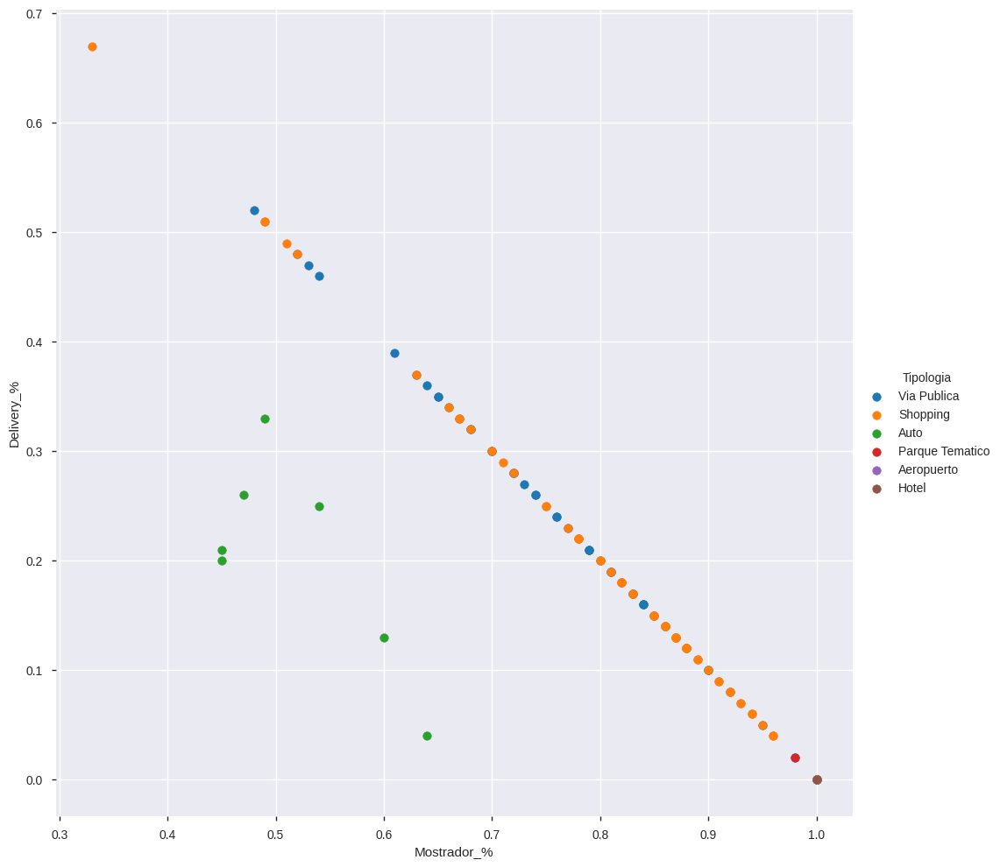

In [54]:
# Hacemos un FacetGrid de Tipologia 'Mostrador_%' vs 'Delivery_%'
sns.FacetGrid(df,hue = 'Tipologia' , height = 10).map(plt.scatter,'Mostrador_%','Delivery_%').add_legend();
plt.show()

Joint plot de Ventas Anuales con otras variables ==> 

Correlacion entre Ventas Promedio Mes y Delivery_% ==>  -0.06522167080178413
Correlacion entre Ventas Promedio Mes y Auto_% ==>  0.42698457699261855
Correlacion entre Ventas Promedio Mes y Mostrador_% ==>  -0.10767903150792972


<Figure size 500x400 with 0 Axes>

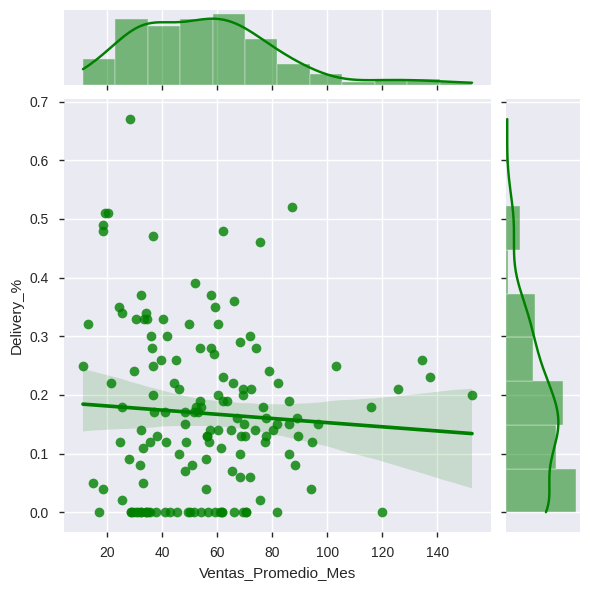

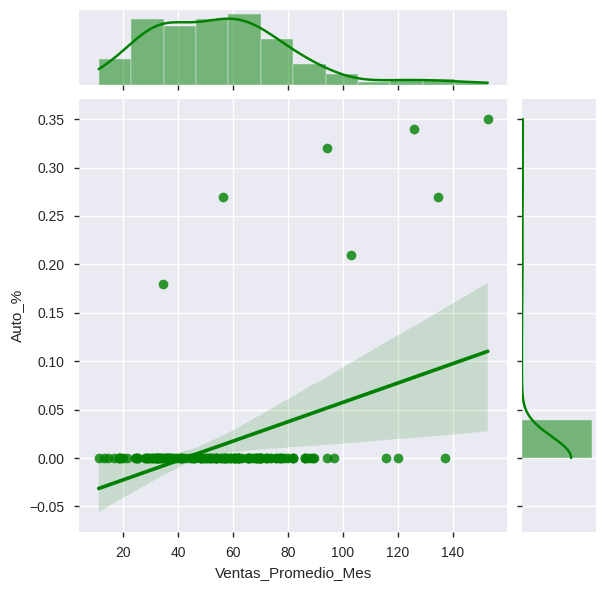

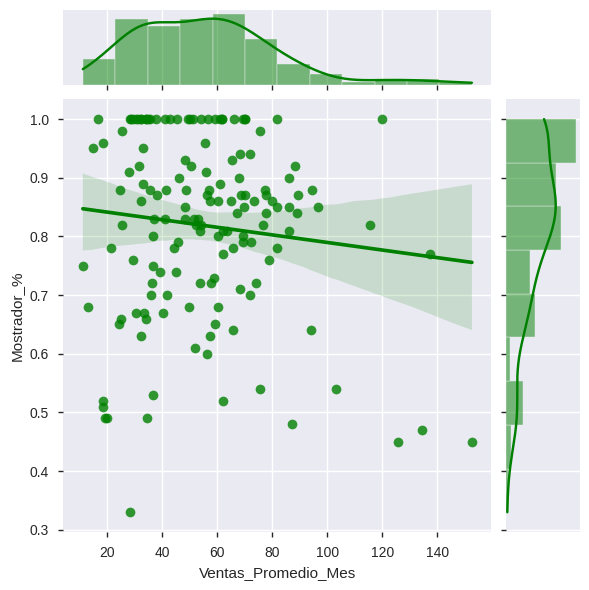

In [56]:
#Creamos un join plot entre Ventas_Promedio_Mes y el resto de las variables con su interpretación.

col = list(df.columns)
idx = col.index('Ventas_Promedio_Mes')

plt.figure(dpi = 100, figsize = (5,4))
print("Joint plot de Ventas Anuales con otras variables ==> \n")
for i in  range(idx+1,len(col)-1):
    print(f"Correlacion entre Ventas Promedio Mes y {col[i]} ==> ",df.corr().loc['Ventas_Promedio_Mes'][col[i]])
    sns.jointplot(x='Ventas_Promedio_Mes',y=col[i],data=df,kind = 'reg',color = 'green')
    plt.show()

Joint plot de Auto con otras variables ==> 

Correlacion entre Auto y Mostrador_% ==>  -0.42308865958332176


<Figure size 1200x480 with 0 Axes>

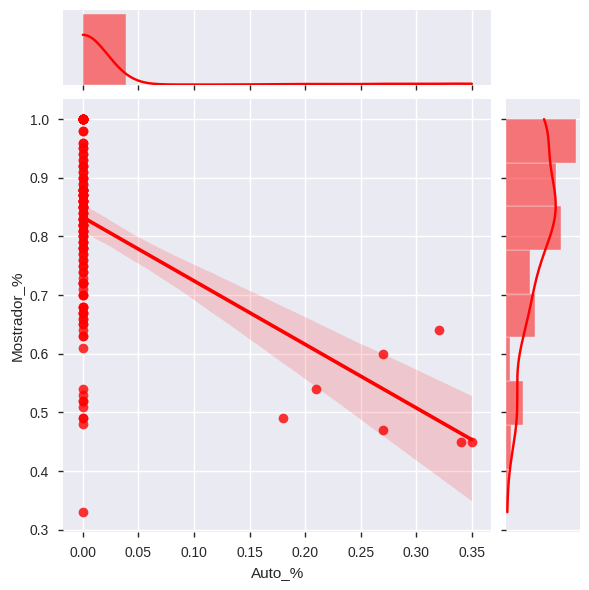

In [57]:
#Creamos un join plot entre 'Auto_% y el resto de las variables con su interpretación.

col = list(df.columns)
idx = col.index('Auto_%')

plt.figure(dpi = 120, figsize = (10,4))
print("Joint plot de Auto con otras variables ==> \n")
for i in  range(idx+1,len(col)-1):
    print(f"Correlacion entre Auto y {col[i]} ==> ",df.corr().loc['Auto_%'][col[i]])
    sns.jointplot(x='Auto_%',y=col[i],data=df,kind = 'reg',color = 'red')
    plt.show()

Joint plot de Delivery con otras variables ==> 

Correlacion entre Delivery y Auto_% ==>  0.03574716813803806
Correlacion entre Delivery y Mostrador_% ==>  -0.9206333976482243


<Figure size 1200x480 with 0 Axes>

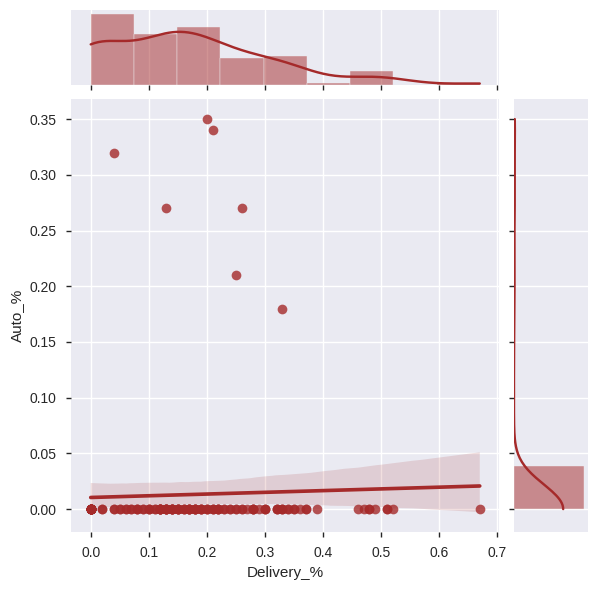

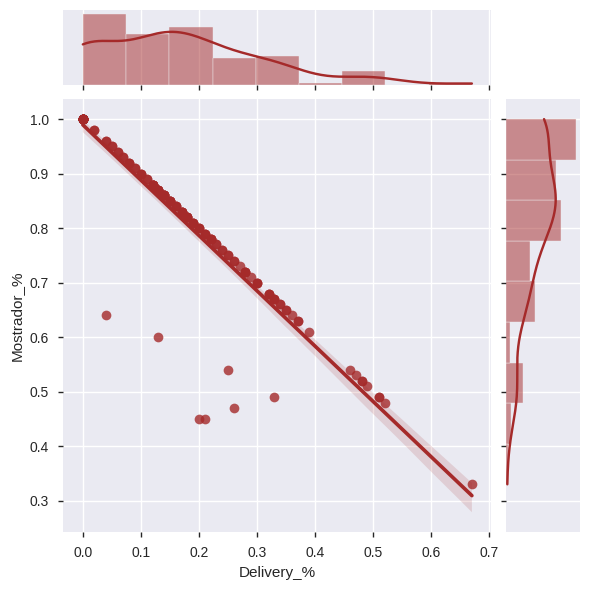

In [59]:
#Creamos un join plot entre 'Delivery_% y el resto de las variables con su interpretación.

col = list(df.columns)
idx = col.index('Delivery_%')

plt.figure(dpi = 120, figsize = (10,4))
print("Joint plot de Delivery con otras variables ==> \n")
for i in  range(idx+1,len(col)-1):
    print(f"Correlacion entre Delivery y {col[i]} ==> ",df.corr().loc['Delivery_%'][col[i]])
    sns.jointplot(x='Delivery_%',y=col[i],data=df,kind = 'reg',color = 'brown')
    plt.show()

Joint plot de Ventas Anuales con otras variables ==> 

Correlacion entre Total meses abierto y Venta_2019 ==>  0.6825778727439114
Correlacion entre Total meses abierto y Venta_2020 ==>  0.576466949836896
Correlacion entre Total meses abierto y Venta_2021 ==>  0.40720023747350226
Correlacion entre Total meses abierto y Venta_2022 ==>  0.08617198096643036
Correlacion entre Total meses abierto y Total_Ventas ==>  0.6097215447116262
Correlacion entre Total meses abierto y Ventas_Promedio_Mes ==>  0.06724985116785735
Correlacion entre Total meses abierto y Delivery_% ==>  0.33506166536178433
Correlacion entre Total meses abierto y Auto_% ==>  -0.031030555325694677
Correlacion entre Total meses abierto y Mostrador_% ==>  -0.29166666240747585


<Figure size 500x400 with 0 Axes>

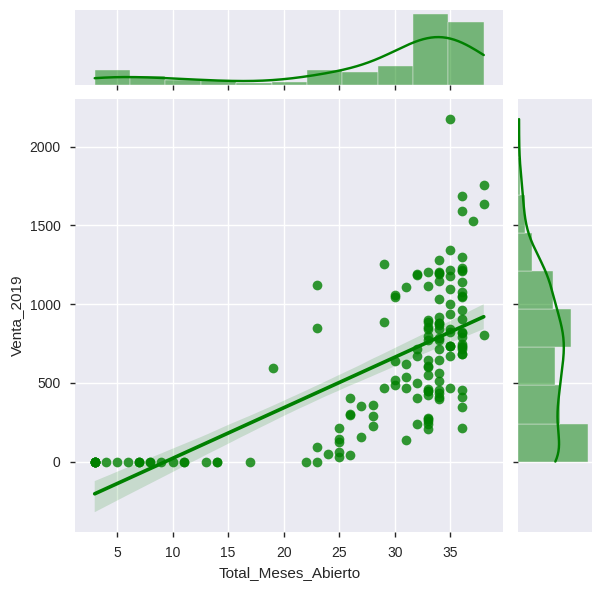

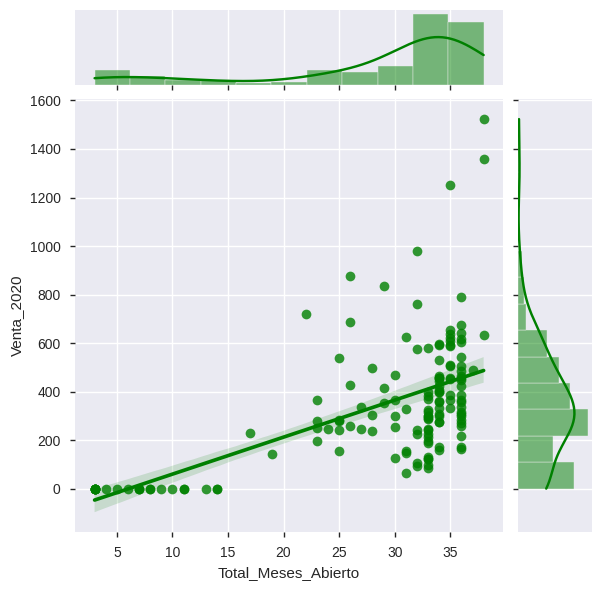

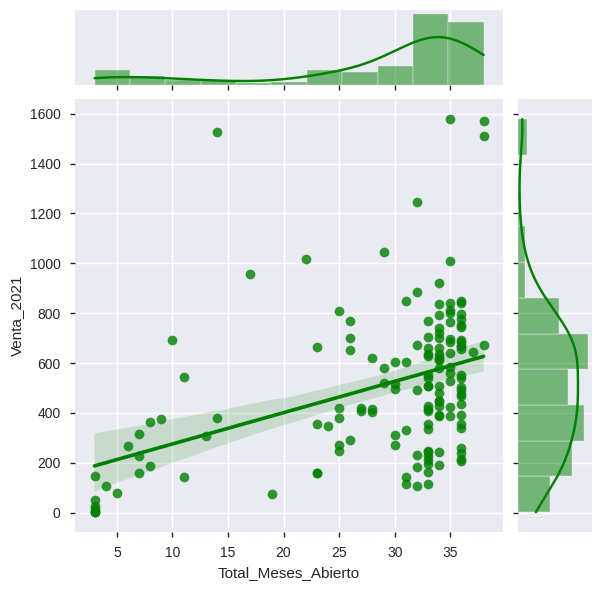

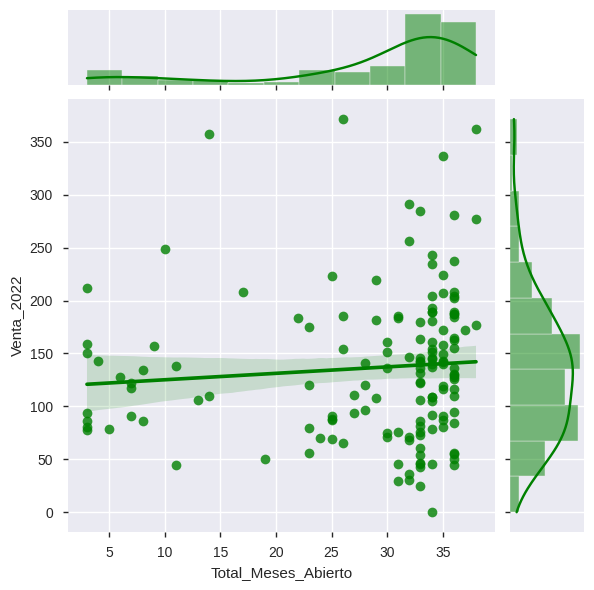

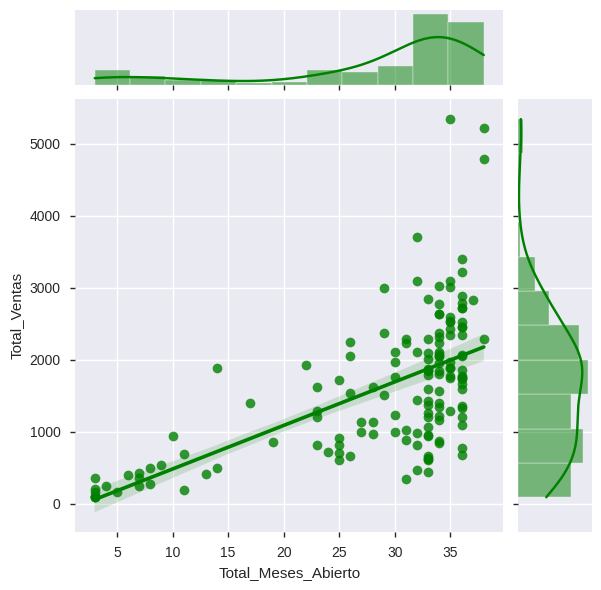

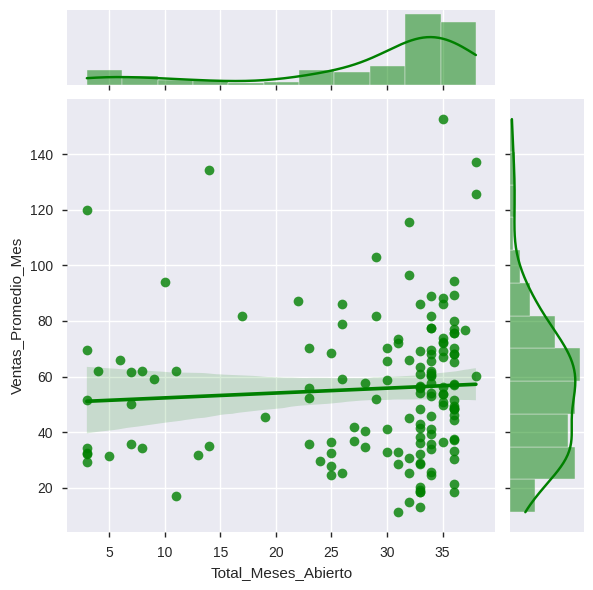

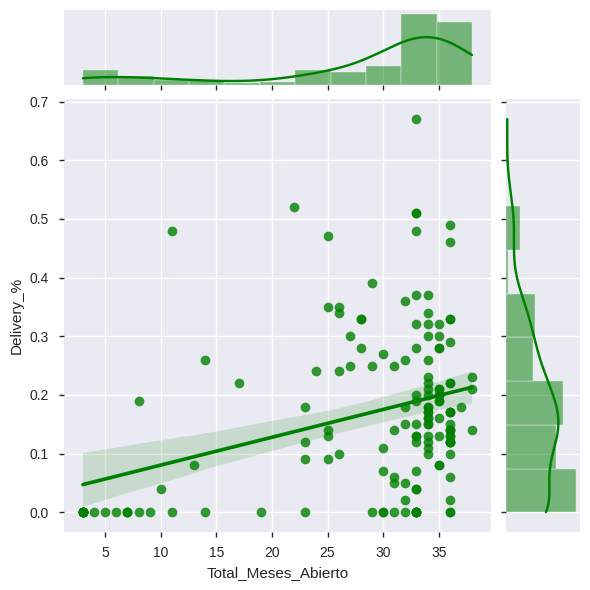

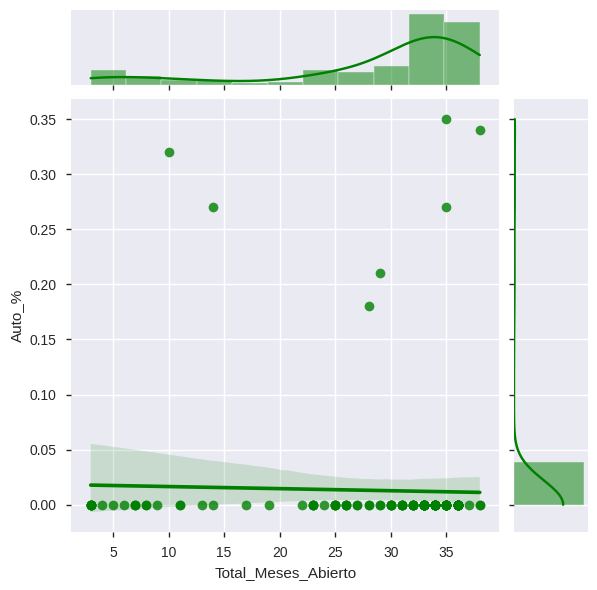

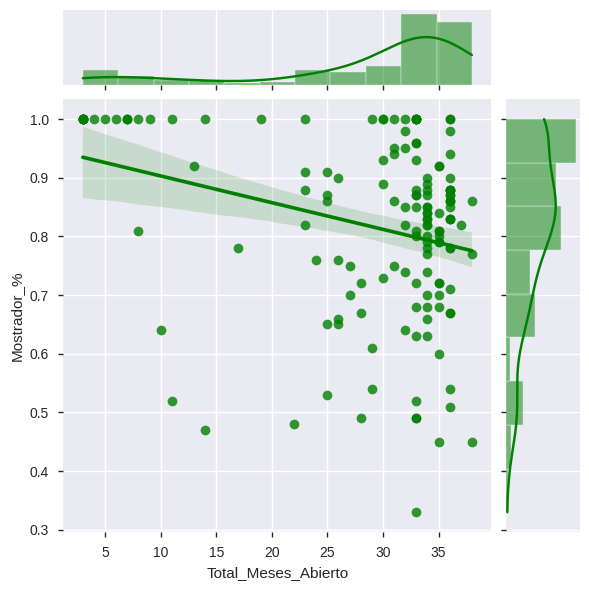

In [66]:
#Creamos un join plot entre Total meses abierto y el resto de las variables con su interpretación.

col = list(df.columns)
idx = col.index('Total_Meses_Abierto')

plt.figure(dpi = 100, figsize = (5,4))
print("Joint plot de Ventas Anuales con otras variables ==> \n")
for i in  range(idx+1,len(col)-1):
    print(f"Correlacion entre Total meses abierto y {col[i]} ==> ",df.corr().loc['Total_Meses_Abierto'][col[i]])
    sns.jointplot(x='Total_Meses_Abierto',y=col[i],data=df,kind = 'reg',color = 'green')
    plt.show()